# 2D object tracking learning and inferencing using Detectron2 

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

Here, we will go through installing detectron2, including the following:
* Run inference on images with an existing detectron2 model
* Train a detectron2 model on a new dataset
*  evaluation 

You can make a copy of this project by "File -> Open in playground mode" and make changes there. __DO NOT__ request access to this project.


# Install detectron2

In [ ]:
!pip install pyyaml==5.1
# workaround: install old version of pytorch since detectron2 hasn't released packages for pytorch 1.9 (issue: https://github.com/facebookresearch/detectron2/issues/3158)
!pip install torch==1.8.0+cu101 torchvision==0.9.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html

# install detectron2 that matches pytorch 1.8
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

     |████████████████████████████████| 274 kB 5.3 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=0241097207416e297e17bf2fef2a00daa004105f908de09d3a3b158a8c392dcc
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 763.5 MB 15 kB/s 
     |████████████████████████████████| 17.3 MB 168 kB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successf

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
     |████████████████████████████████| 6.3 MB 843 kB/s 
     |████████████████████████████████| 130 kB 5.3 MB/s 
     |████████████████████████████████| 49 kB 5.3 MB/s 
     |████████████████████████████████| 74 kB 3.3 MB/s 
     |████████████████████████████████| 145 kB 39.7 MB/s 
     |████████████████████████████████| 743 kB 35.7 MB/s 
     |████████████████████████████████| 745 kB 35.0 MB/s 
     |████████████████████████████████| 112 kB 50.4 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20210825-py3-none-any.whl size=60661 sha256=58d3b05d05127a1d31edb3a136a0d7b659fc324f54429c505650994f7024a562
  Stored in directory: /root/.cache/pip/wheels/53/c4/f8/c4cb07f135845218b019b4a55d8a0470a0f21ee13f8dcd16be
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-py3-none-any.whl size=141230 sha256=26f2003e425b059d44e2746ad1b6647f04bee0a6f805cd4048bb0035159ed8e

In [ ]:
# check pytorch installation: 
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.8")   # please manually install torch 1.8 if Colab changes its default version

1.9.0+cu102 True


AssertionError: ignored

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Try a pre-trained detectron2 model

We first test an image from the our dataset:

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# import cv2
# im = cv2.imread("/content/drive/MyDrive/data/train/frame_20200318_08_42_33_668_left.png")
# cv2_imshow(im)

Mounted at /content/drive


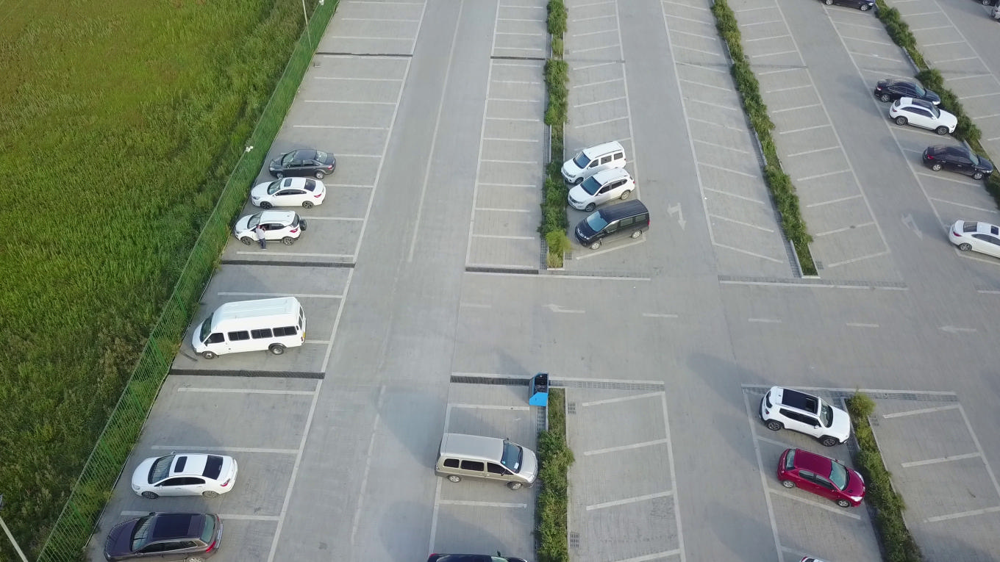

In [ ]:
import cv2
im = cv2.imread("/content/drive/MyDrive/visdata/tests/uav0000009_03358_v0000003.jpg")
cv2_imshow(im)

In [ ]:
!unrar x "/content/drive/MyDrive/visdata.rar" "/content/drive/MyDrive/visdata"


Streaming output truncated to the last 5000 lines.
Extracting  /content/drive/MyDrive/visdata/visdata/train/uav0000352_05980_v0000151.jpg      82%  OK 
Extracting  /content/drive/MyDrive/visdata/visdata/train/uav0000352_05980_v0000152.jpg      82%  OK 
Extracting  /content/drive/MyDrive/visdata/visdata/train/uav0000352_05980_v0000153.jpg      82%  OK 
Extracting  /content/drive/MyDrive/visdata/visdata/train/uav0000352_05980_v0000154.jpg      82%  OK 
Extracting  /content/drive/MyDrive/visdata/visdata/train/uav0000352_05980_v0000155.jpg      82%  OK 
Extracting  /content/drive/MyDrive/visdata/visdata/train/uav0000352_05980_v0000156.jpg      82%  OK 
Extracting  /content/drive/MyDrive/visdata/visdata/train/uav0000352_05980_v0000157.jpg      82%  OK 
Extracting  /content/drive/MyDrive/visdata/visdata/train/uav0000352_05980_v0000158.jpg      82%  OK 
Extracting  /content/drive/MyDrive/visdata/visdata/train/uav0000352_0

# Filter method 

In [ ]:
from detectron2.structures.instances import Instances
def filter_outputs(outputs, need_set, nms_thresh=None, confid_thresh=None):
    """
    Filter outputs to detect objects only from needed classes
    :param outputs:
    :param need_set:
    :return:
    """
    boxes = outputs.pred_boxes if outputs.has("pred_boxes") else None
    scores = outputs.scores if outputs.has("scores") else None
    classes = outputs.pred_classes if outputs.has("pred_classes") else None
    new_classes = []
    new_scores = []
    ids = []
    for idx, x in enumerate(classes):
        if confid_thresh:
            if scores[idx] >= confid_thresh:
                if int(x) in need_set:
                    new_classes.append(int(x))
                    new_scores.append(scores[idx])
                    ids.append(idx)
        else:
            if int(x) in need_set:
                new_classes.append(int(x))
                new_scores.append(scores[idx])
                ids.append(idx)
    boxes = boxes[ids] if boxes is not None else None

    if nms_thresh is not None:
        boxes = convert_boxes(boxes)
        new_scores = np.array(new_scores)
        new_classes = np.array(new_classes)
        boxes, pick = fast_nms(boxes, overlapThresh=nms_thresh)
        new_classes = new_classes[pick]
        new_scores = new_scores[pick]

    new_outputs = Instances(outputs.image_size)
    new_outputs.set("pred_boxes", boxes)
    new_outputs.set(("scores"), new_scores)
    new_outputs.set("pred_classes", new_classes)
    return new_outputs

Then, we create a detectron2 config and a detectron2 `DefaultPredictor` to run inference on this image.

In [ ]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_DC5_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. 
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_DC5_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)
# another equivalent way to evaluate the model is to use `trainer.test`

model_final_68d202.pkl: 663MB [00:15, 42.8MB/s]                           


NameError: ignored

In [ ]:
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([ 2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2, 56,  2],
       device='cuda:0')
Boxes(tensor([[ 339.1316,  240.0101,  445.6712,  285.0215],
        [ 136.8202,  690.4817,  305.5172,  764.6216],
        [1052.4713,  605.5391, 1176.4961,  695.6690],
        [ 317.0588,  286.0804,  414.1783,  337.9422],
        [ 363.0233,  203.3303,  460.4728,  244.8284],
        [ 775.6521,  271.1003,  883.7684,  339.6646],
        [1185.4487,  106.1458, 1280.8085,  146.6211],
        [1030.8801,  526.4449, 1152.6337,  613.3406],
        [1207.5865,  134.7418, 1302.9097,  184.7596],
        [1252.2712,  191.9990, 1354.8776,  250.7834],
        [ 767.7960,  230.0446,  866.8308,  292.4456],
        [1291.6825,  297.3310, 1360.0000,  351.1183],
        [ 257.8199,  402.8099,  421.0756,  487.8963],
        [ 181.4566,  612.1841,  324.5816,  679.3438],
        [1119.6062,    0.0000, 1191.6450,   18.6515],
        [ 764.6279,  193.3606,  855.2891,  250.5343],
        [ 684.1056,  602.

# image without implementing Filtering method

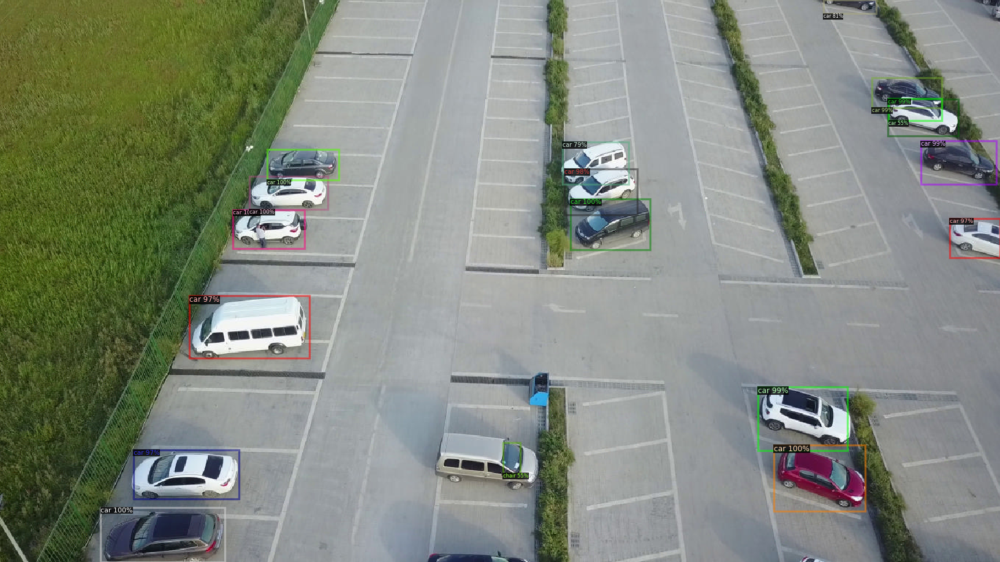

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

# image with implementing Filtering method

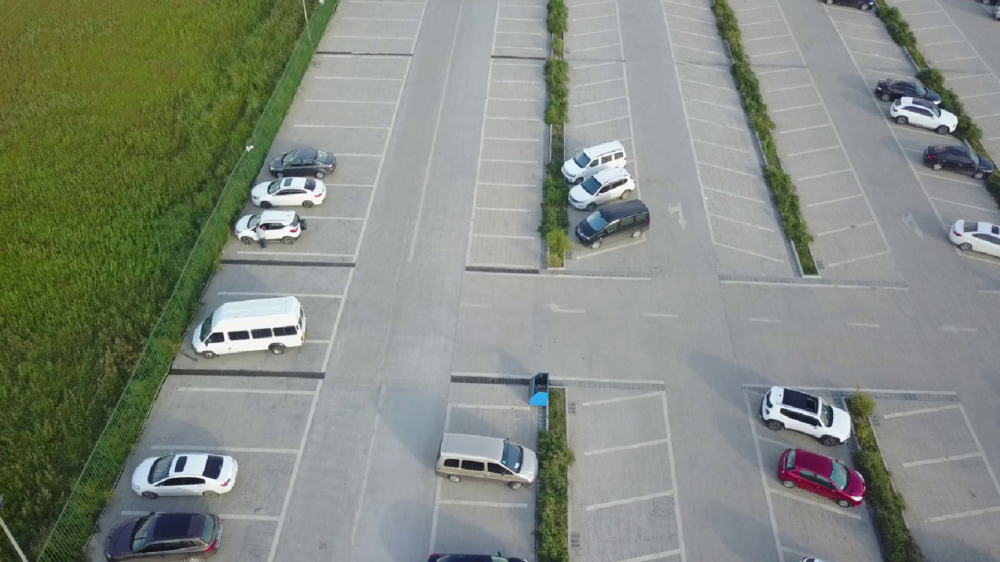

In [ ]:
need_set = [0]
preds = filter_outputs(outputs["instances"], need_set, nms_thresh=None, confid_thresh=0)
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(preds.to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

# Train on our dataset (custom)

In this section, we show how to train an existing detectron2 model on a our dataset in a new format.
our dataset only has one class: Person.




#Register the our dataset to detectron2



In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("detect_train2", {}, "/content/drive/MyDrive/visdata/train/train2.json", "/content/drive/MyDrive/visdata/train")
register_coco_instances("detect_val2", {}, "/content/drive/MyDrive/visdata/validation/validation2.json", "/content/drive/MyDrive/visdata/validation")
register_coco_instances("detect_test2", {}, "/content/drive/MyDrive/visdata/tests/test2.json", "/content/drive/MyDrive/visdata/tests")

## Train!

Now, let's fine-tune a COCO-pretrained all Zoo-model on our  dataset. It takes ~6 minutes to train 300 iterations on Colab's K80 GPU, or ~2 minutes on a P100 GPU.


In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_DC5_3x.yaml"))
cfg.DATASETS.TRAIN = ("detect_train2",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_DC5_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00030  # pick a good LR
cfg.SOLVER.MAX_ITER = 600   # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # only has one class (Person). 
# cfg.MODEL.RETINANET.NUM_CLASSES=1 #this row for retinanet network
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[08/29 06:10:51 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

model_final_68d202.pkl: 663MB [00:21, 30.9MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_pre

[08/29 06:13:22 d2.engine.train_loop]: Starting training from iteration 0
[08/29 06:14:31 d2.utils.events]:  eta: 0:32:59  iter: 19  total_loss: 1.635  loss_cls: 1.116  loss_box_reg: 0.4031  loss_rpn_cls: 0.08195  loss_rpn_loc: 0.03741  time: 3.3719  data_time: 0.0348  lr: 9.7905e-06  max_mem: 4134M
[08/29 06:15:36 d2.utils.events]:  eta: 0:32:11  iter: 39  total_loss: 1.693  loss_cls: 1.026  loss_box_reg: 0.5365  loss_rpn_cls: 0.0641  loss_rpn_loc: 0.04283  time: 3.3070  data_time: 0.0071  lr: 1.9781e-05  max_mem: 4134M
[08/29 06:16:42 d2.utils.events]:  eta: 0:30:56  iter: 59  total_loss: 1.533  loss_cls: 0.8388  loss_box_reg: 0.5116  loss_rpn_cls: 0.07221  loss_rpn_loc: 0.0327  time: 3.3132  data_time: 0.0073  lr: 2.977e-05  max_mem: 4134M
[08/29 06:17:47 d2.utils.events]:  eta: 0:29:44  iter: 79  total_loss: 1.297  loss_cls: 0.7144  loss_box_reg: 0.4911  loss_rpn_cls: 0.07724  loss_rpn_loc: 0.03797  time: 3.2879  data_time: 0.0069  lr: 3.976e-05  max_mem: 4134M
[08/29 06:18:55 d2.u

In [ ]:
!cp /content/output/model_0004999.pth /content/drive/MyDrive

# If u want to take a Look at training curves using tensorboard

In [ ]:

%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Inference & evaluation using our trained model
Now, let's run inference with the trained model on the our validation dataset. First, we create a predictor using the model we just trained:



In [ ]:
cd MyDrive/output/

/content/drive/MyDrive/output


In [ ]:
import cv2
#/content/drive/MyDrive/result1/frame_0.jpg
#/content/drive/MyDrive/result1/frame_10.jpg
im = cv2.imread("/content/drive/MyDrive/result1/frame_0.jpg")
cv2_imshow(im)
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
class KalmanFilter(object):
    def __init__(self, dt, u_x,u_y, std_acc, x_std_meas, y_std_meas):
        """
        :param dt: sampling time (time for 1 cycle)
        :param u_x: acceleration in x-direction
        :param u_y: acceleration in y-direction
        :param std_acc: process noise magnitude
        :param x_std_meas: standard deviation of the measurement in x-direction
        :param y_std_meas: standard deviation of the measurement in y-direction
        """
        # Define sampling time
        self.dt = dt
        # Define the  control input variables
        self.u = np.matrix([[u_x],[u_y]])
        # Intial State
        self.x = np.matrix([[0], [0], [0], [0]])
        # Define the State Transition Matrix A
        self.A = np.matrix([[1, 0, self.dt, 0],
                            [0, 1, 0, self.dt],
                            [0, 0, 1, 0],
                            [0, 0, 0, 1]])
        # Define the Control Input Matrix B
        self.B = np.matrix([[(self.dt**2)/2, 0],
                            [0, (self.dt**2)/2],
                            [self.dt,0],
                            [0,self.dt]])
        # Define Measurement Mapping Matrix
        self.H = np.matrix([[1, 0, 0, 0],
                            [0, 1, 0, 0]])
        #Initial Process Noise Covariance
        self.Q = np.matrix([[(self.dt**4)/4, 0, (self.dt**3)/2, 0],
                            [0, (self.dt**4)/4, 0, (self.dt**3)/2],
                            [(self.dt**3)/2, 0, self.dt**2, 0],
                            [0, (self.dt**3)/2, 0, self.dt**2]]) * std_acc**2
        #Initial Measurement Noise Covariance
        self.R = np.matrix([[x_std_meas**2,0],
                           [0, y_std_meas**2]])
        #Initial Covariance Matrix
        self.P = np.eye(self.A.shape[1])
    def predict(self):
        # Refer to :Eq.(9) and Eq.(10)  in https://machinelearningspace.com/object-tracking-simple-implementation-of-kalman-filter-in-python/?preview_id=1364&preview_nonce=52f6f1262e&preview=true&_thumbnail_id=1795
        # Update time state
        #x_k =Ax_(k-1) + Bu_(k-1)     Eq.(9)
        self.x = np.dot(self.A, self.x) + np.dot(self.B, self.u)
        # Calculate error covariance
        # P= A*P*A' + Q               Eq.(10)
        self.P = np.dot(np.dot(self.A, self.P), self.A.T) + self.Q
        return self.x[0:2]
    def update(self, z):
        # Refer to :Eq.(11), Eq.(12) and Eq.(13)  in https://machinelearningspace.com/object-tracking-simple-implementation-of-kalman-filter-in-python/?preview_id=1364&preview_nonce=52f6f1262e&preview=true&_thumbnail_id=1795
        # S = H*P*H'+R
        S = np.dot(self.H, np.dot(self.P, self.H.T)) + self.R
        # Calculate the Kalman Gain
        # K = P * H'* inv(H*P*H'+R)
        K = np.dot(np.dot(self.P, self.H.T), np.linalg.inv(S))  #Eq.(11)
        self.x = np.round(self.x + np.dot(K, (z - np.dot(self.H, self.x))))   #Eq.(12)
        I = np.eye(self.H.shape[1])
        # Update error covariance matrix
        self.P = (I - (K * self.H)) * self.P   #Eq.(13)
        return self.x[0:2]

In [ ]:
    def predict(self):
        # Refer to :Eq.(9) and Eq.(10)  in https://machinelearningspace.com/object-tracking-simple-implementation-of-kalman-filter-in-python/?preview_id=1364&preview_nonce=52f6f1262e&preview=true&_thumbnail_id=1795
        # Update time state
        #x_k =Ax_(k-1) + Bu_(k-1)     Eq.(9)
        self.x = np.dot(self.A, self.x) + np.dot(self.B, self.u)
        # Calculate error covariance
        # P= A*P*A' + Q               Eq.(10)
        self.P = np.dot(np.dot(self.A, self.P), self.A.T) + self.Q
        return self.x[0:2]

In [ ]:
    def update(self, z):
        # Refer to :Eq.(11), Eq.(12) and Eq.(13)  in https://machinelearningspace.com/object-tracking-simple-implementation-of-kalman-filter-in-python/?preview_id=1364&preview_nonce=52f6f1262e&preview=true&_thumbnail_id=1795
        # S = H*P*H'+R
        S = np.dot(self.H, np.dot(self.P, self.H.T)) + self.R
        # Calculate the Kalman Gain
        # K = P * H'* inv(H*P*H'+R)
        K = np.dot(np.dot(self.P, self.H.T), np.linalg.inv(S))  #Eq.(11)
        self.x = np.round(self.x + np.dot(K, (z - np.dot(self.H, self.x))))   #Eq.(12)
        I = np.eye(self.H.shape[1])
        # Update error covariance matrix
        self.P = (I - (K * self.H)) * self.P   #Eq.(13)
        return self.x[0:2]

In [ ]:
import numpy as np
import cv2
def detect(frame,predictor):
    centers=[]
    contours = predictor(frame)["instances"].get_fields()["pred_boxes"].tensor.cpu().numpy()
    for box in contours:
        xleft = box[0]
        yleft = box[1]
        xright = box[2]
        yright = box[3]
        width = np.abs(xleft-xright)
        height = np.abs(yleft-yright)
        centerx = width/2 + xleft
        centery = height/2 + yleft
        centers.append(np.array([[centerx], [centery]]))
    return centers

In [ ]:
cd MyDrive/

/content/drive/MyDrive


['lala/0000039.jpg', 'lala/0000066.jpg', 'lala/0000144.jpg', 'lala/0000085.jpg', 'lala/0000135.jpg', 'lala/0000011.jpg', 'lala/0000099.jpg', 'lala/0000121.jpg', 'lala/0000031.jpg', 'lala/0000128.jpg', 'lala/0000096.jpg', 'lala/0000023.jpg', 'lala/0000027.jpg', 'lala/0000086.jpg', 'lala/0000068.jpg', 'lala/0000032.jpg', 'lala/0000044.jpg', 'lala/0000104.jpg', 'lala/0000008.jpg', 'lala/0000057.jpg', 'lala/0000025.jpg', 'lala/0000043.jpg', 'lala/0000129.jpg', 'lala/0000141.jpg', 'lala/0000084.jpg', 'lala/0000051.jpg', 'lala/0000015.jpg', 'lala/0000058.jpg', 'lala/0000090.jpg', 'lala/0000145.jpg', 'lala/0000006.jpg', 'lala/0000102.jpg', 'lala/0000020.jpg', 'lala/0000114.jpg', 'lala/0000047.jpg', 'lala/0000119.jpg', 'lala/0000103.jpg', 'lala/0000049.jpg', 'lala/0000117.jpg', 'lala/0000101.jpg', 'lala/0000125.jpg', 'lala/0000016.jpg', 'lala/0000074.jpg', 'lala/0000001.jpg', 'lala/0000093.jpg', 'lala/0000112.jpg', 'lala/0000035.jpg', 'lala/0000097.jpg', 'lala/0000133.jpg', 'lala/0000089.jpg',

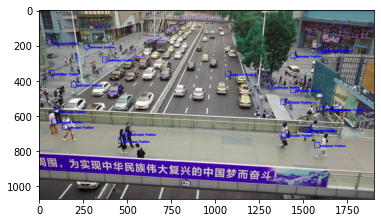

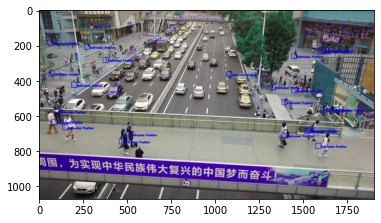

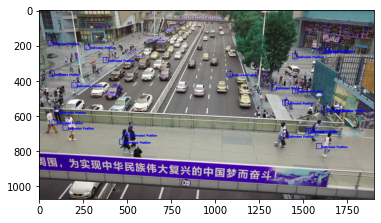

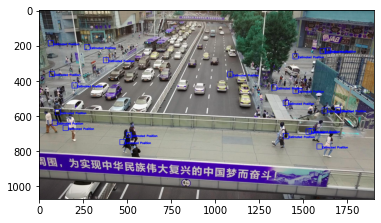

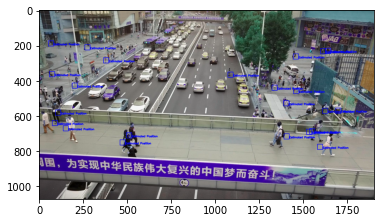

...

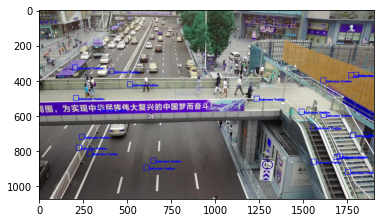

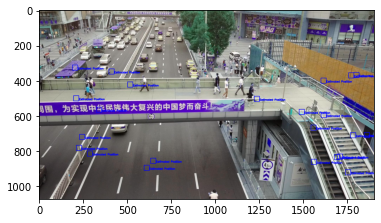

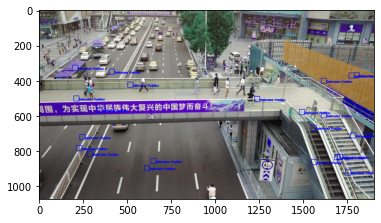

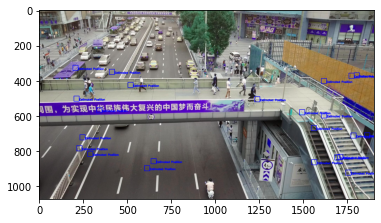

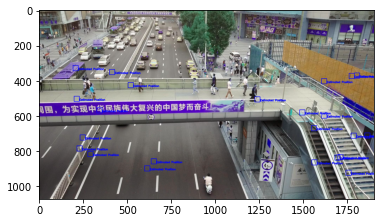

In [ ]:
:::
import cv2
import glob

#Create KalmanFilter object KF
#KalmanFilter(dt, u_x, u_y, std_acc, x_std_meas, y_std_meas)

# Create opencv video capture object
# VideoCap = cv2.VideoCapture('/content/drive/MyDrive/lala.avi')
# ret, frame = VideoCap.read()
frames = glob.glob('video_base_2/*.jpg')

base = 'video_base_2/0000001.jpg'
frames.remove(base)
frames.sort()
base_frame = cv2.imread(base)
centers = detect(base_frame,predictor=predictor)

filters = []
for i in range(len(centers)):
  KF = KalmanFilter(0.1, 1, 1, 1, 0.1,0.1)
  filters.append(KF)

predicted = []
updated = []
counter= 0
for center in centers:
  cv2.circle(base_frame, (int(center[0]), int(center[1])), 10, (0, 191, 255), 2)
# cv2_imshow(base_frame)
for frame in frames:
  frame = cv2.imread(frame)
  if counter ==0:
        # Draw the detected circle
        # cv2.circle(frame, (int(centers[0][0]), int(centers[0][1])), 10, (0, 191, 255), 2)
        # Predict
        for center in range(len(centers)):
            (x, y) = filters[center].predict()
            (x1, y1) = filters[center].update(centers[center])
            x , y = (x,y)
            x1 , y1 = (x1,y1)
            updated.append(np.array([[float(x1)], [float(y1)]]))
            predicted.append(np.array([[float(x)], [float(y)]]))
     
  elif counter%10 != 0 :
       for point in range(len(predicted)):
          (x, y) = filters[point].predict()
          (x1, y1) = filters[point].update(updated[point])
          predicted[point] = np.array([[float(x)], [float(y)]])
          updated[point] = np.array([[float(x1)], [float(y1)]])
  else:
      centers = detect(frame,predictor=predictor)
      filters.clear()
      predicted.clear()
      updated.clear()
      for i in range(len(centers)):
            KF = KalmanFilter(0.1, 1, 1, 1, 0.1,0.1)
            filters.append(KF)
      for center in range(len(centers)):
            (x, y) = filters[center].predict()
            (x1, y1) = filters[center].update(centers[center])
            x , y = (x,y)
            x1 , y1 = (x1,y1)
            updated.append(np.array([[float(x1)], [float(y1)]]))
            predicted.append(np.array([[float(x)], [float(y)]]))

       

  for point in range(len(predicted)):
    x,y = predicted[point]
    x1,y1 = updated[point]
    # Draw a rectangle as the predicted object position
    cv2.rectangle(frame, (x - 15, y - 15), (x + 15, y + 15), (255, 0, 0), 2)
    # Draw a rectangle as the estimated object position
    cv2.rectangle(frame, (x1 - 15, y1 - 15), (x1 + 15, y1 + 15), (0, 0, 255), 2)
    cv2.putText(frame, "Estimated Position", (x1 + 15, y1 + 10), 0, 0.5, (0, 0, 255), 2)
    cv2.putText(frame, "Predicted Position", (x + 15, y), 0, 0.5, (255, 0, 0), 2)
    # cv2.putText(frame, "Measured Position", (centers[0][0] + 15, centers[0][1] - 15), 0, 0.5, (0,191,255), 2)

  # cv2_imshow(frame)
  cv2.imwrite("/content/drive/MyDrive/result2/frame_{}.jpg".format(counter),frame)
  counter+=1

# We will evaluate the performance using AP metric implemented in COCO API.
# Then we are going to comper the result

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("detect_test2", ("bbox",), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "detect_test2")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way to evaluate the model is to use `trainer.test`

[07/21 11:33:10 d2.data.datasets.coco]: Loading /content/drive/MyDrive/visdata/tests/test2.json takes 1.03 seconds.
[07/21 11:33:10 d2.data.datasets.coco]: Loaded 6142 images in COCO format from /content/drive/MyDrive/visdata/tests/test2.json
[07/21 11:33:11 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
| pedestrain | 106184       |   people   | 33999        |
|            |              |            |              |
|   total    | 140183       |            |              |
[07/21 11:33:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[07/21 11:33:11 d2.data.common]: Serializing 6142 elements to byte tensors and concatenating them all ...
[07/21 11:33:11 d2.data.common]: Serialized dataset takes 9.12 MiB
[07/21 11:33:11 d2.evaluation.eva